# Capstone Project - The Battle of the Neighborhoods
## Applied Data Science Capstone by IBM/Coursera

### Table of Contents
[1. Introduction](#introduction)

[2. Data](#data)

[3. Methodology](#methodology)

[4. Results](#results)

[5. Discussion](#discussion)

[6. Conclusion](#conclusion)

<a id='introduction'></a>
# 1. Introduction

Healthcare facilities are important to provide continuous and timely care to the patients. They play an important role in our society to mitigate disasters ranging from personal injuries and ailment to coping with the spread of diseases such as in a situation of a epidemic or pandemic. The state of New York has various healthcare facilities including hospitals, urgent care facilities, specialty facilities such as radiation or hemodialysis centers. 

In this exercise, I'd like to get an understanding of the availability of the healthcare facilities in the state of New York, particularly in New York City, in terms of the type of the facilities and their capacity, and identify the differences in resource among 5 different counties in New York City by machine learning methods such as clustering. The goal is to understand the resource availability and the diversity of the resource distribution. 

<a id='data'></a>
# 2. Data

Find a list of counties of the state of New York

In [3]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
import matplotlib as mpl
import matplotlib.pyplot as plt

In [217]:
import sys
# Install Beautiful Soup and parser
!{sys.executable} -m pip install beautifulsoup4
!{sys.executable} -m pip install lxml

#import beautiful soup library
from bs4 import BeautifulSoup
import requests

You should consider upgrading via the 'C:\ProgramData\Anaconda3\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'C:\ProgramData\Anaconda3\python.exe -m pip install --upgrade pip' command.


In [50]:
# Load html
url = requests.get('https://en.wikipedia.org/wiki/List_of_counties_in_New_York')

# construct BeautifulSoup object 
soup = BeautifulSoup(url.text, 'lxml')

In [51]:
# Extract the county names from html file and convert to DataFrame
table = soup.find('table', attrs={'class':'wikitable sortable'})
data = []
header = table.find_all('th')
county_names =[]
for th in header:
    county = [th.text.replace('County\n', ' ').strip()]
    county_names.append(county)
county_names = pd.DataFrame(county_names[10:], columns = ['County'])
county_names.head()

,County
0,Albany
1,Allegany
2,Bronx
3,Broome
4,Cattaraugus


In [52]:
# Extract the rest of the table and convert to DataFrame
table_rows = table.find_all('tr')
for tr in table_rows:
    td = tr.find_all('td')
    row = [tr.text.replace('\n', ' ').strip() for tr in td]
    data.append(row)
nycounties = pd.DataFrame(data)
nycounties.head()

,0,1,2,3,4,5,6,7,8
0,None,None,None,None,None,None,None,None,None
1,001,Albany,1683,One of 12 original counties created in the New...,James II of England (James VII of Scotland) (1...,570.74,"304,204","533 sq mi(1,380 km2)",
2,003,Belmont,1806,Genesee County,A variant spelling of the Allegheny River,47.34,"48,946","1,034 sq mi(2,678 km2)",
3,005,none,1914[7],New York County,"Jonas Bronck (1600?–1643), an early settler of...","24,118.20","1,385,108",57.43 sq mi(149 km2),
4,007,Binghamton,1806,Tioga County,"John Broome (1738–1810), fourth Lieutenant Gov...",280.56,"200,600","715 sq mi(1,852 km2)",


Check if the location of Albany was found on map correctly

In [53]:
import folium
import requests

# Use Albany as map center since it's the capital of the state
address = 'Albany, New York'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

# create map of New York using latitude and longitude values
map_albany = folium.Map(location=[latitude, longitude], zoom_start=10)
map_albany

Use Foursquare to find hospitals in Albany county

In [54]:
# Define Foursquare Credentials and Version
CLIENT_ID = 'UPIAEQLMLMDJSGJ2RZROKAU2CMPXSXG3IM0A0TXUW1ZH4BSC' # your Foursquare ID
CLIENT_SECRET = 'HF3MNXPO4TEQQUYJAYHL5502WIC2ZILUEJIWUOQ5VYNFSO5K' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

# get the top 100 venues that are in Marble Hill within a radius of 500 meters
LIMIT = 300 # limit of number of venues returned by Foursquare API
radius = 50000 # define radius
categoryId = '4bf58dd8d48988d196941735'

url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
    CLIENT_ID,
    CLIENT_SECRET,
    VERSION,
    latitude,
    longitude,
    radius,
    LIMIT,
    categoryId)
print(url) # display URL

# Send the GET request and examine the results
results = requests.get(url).json()
results

Your credentails:
CLIENT_ID: UPIAEQLMLMDJSGJ2RZROKAU2CMPXSXG3IM0A0TXUW1ZH4BSC
CLIENT_SECRET:HF3MNXPO4TEQQUYJAYHL5502WIC2ZILUEJIWUOQ5VYNFSO5K
https://api.foursquare.com/v2/venues/explore?&client_id=UPIAEQLMLMDJSGJ2RZROKAU2CMPXSXG3IM0A0TXUW1ZH4BSC&client_secret=HF3MNXPO4TEQQUYJAYHL5502WIC2ZILUEJIWUOQ5VYNFSO5K&v=20180605&ll=42.6511674,-73.754968&radius=50000&limit=300&categoryId=4bf58dd8d48988d196941735


{'meta': {'code': 400,
  'errorType': 'invalid_auth',
  'errorDetail': 'Missing access credentials. See https://developer.foursquare.com/docs/api/configuration/authentication for details.',
  'requestId': '5f664793459f9f4a8dfe3b85'},
 'response': {}}

Get latitude and longitude for each of the county for Foursquare venue search

In [55]:
# remove first row
nycounties = nycounties.drop(nycounties.index[0])
# only keep the needed columns including county names, density of the population, total population
nycounties = nycounties.iloc[:,[5,6]]
# name corresponding columns
nycounties.columns = ['Population Density (ppl per sq mi)', 'Population']
nycounties.reset_index(drop = True, inplace = True)
nycounties.head()

,Population Density (ppl per sq mi),Population
0,570.74,"304,204"
1,47.34,"48,946"
2,"24,118.20","1,385,108"
3,280.56,"200,600"
4,61.31,"80,317"


In [56]:
ny_counties = pd.concat([county_names, nycounties], axis=1)
ny_counties

,County,Population Density (ppl per sq mi),Population
0,Albany,570.74,"304,204"
1,Allegany,47.34,"48,946"
2,Bronx,"24,118.20","1,385,108"
3,Broome,280.56,"200,600"
4,Cattaraugus,61.31,"80,317"
5,Cayuga,92.62,"80,026"
6,Chautauqua,89.94,"134,905"
7,Chemung,216.23,"88,830"
8,Chenango,56.16,"50,477"
9,Clinton,73.46,"82,128"


In [57]:
# Add Latitude and Longitude columns to dataframe
ny_counties["Latitude"] = ""
ny_counties["Longitude"] = ""

for (index, row) in ny_counties.iterrows():
    locator = Nominatim(user_agent='myGeocoder')
    place = '{}, NY, USA'.format(str(row['County'])+' County')
    g = locator.geocode(place)
    # print(place, 'Lat:', g.latitude, 'Long', g.longitude) 
    ny_counties.loc[index, 'Latitude'] = g.latitude
    ny_counties.loc[index, 'Longitude'] = g.longitude
    
ny_counties.head()

,County,Population Density (ppl per sq mi),Population,Latitude,Longitude
0,Albany,570.74,"304,204",42.5987,-73.9844
1,Allegany,47.34,"48,946",42.2446,-78.0419
2,Bronx,"24,118.20","1,385,108",40.8507,-73.8665
3,Broome,280.56,"200,600",42.1456,-75.8404
4,Cattaraugus,61.31,"80,317",42.2235,-78.6477


In [58]:
nyc_counties = ny_counties.loc[ny_counties['County'].isin(['Bronx','Kings','New York','Queens','Richmond'])]
nyc_county_name = nyc_counties[['County']]
nyc_counties

,County,Population Density (ppl per sq mi),Population,Latitude,Longitude
2,Bronx,"24,118.20","1,385,108",40.8507,-73.8665
23,Kings,"25,848.30","2,504,700",40.6453,-73.955
30,New York,"46,961.00","1,585,873",40.7896,-73.9599
40,Queens,"12,512.46","2,230,722",40.7498,-73.7976
42,Richmond,"4,572.98","468,730",40.5835,-74.1496


Find Medical Centers close to each of the counties in NY. The maximum call limit is 100. Find 100 for counties that have 100 or more, while find all the hospitals for counties that have fewer than 100 hospitals. 

In [98]:
# create a function to repeat the same process to all the counties in NY state

def getMeds(county_names, latitudes, longitudes, radius=10000, LIMIT = 1000,
           CLIENT_ID = 'UPIAEQLMLMDJSGJ2RZROKAU2CMPXSXG3IM0A0TXUW1ZH4BSC', # your Foursquare ID
           CLIENT_SECRET = 'VRYFCA0INAASCELT4I2YARMR43QD3VM5KKLJ3PAAMW2TM2WH', # your Foursquare Secret
           VERSION = '20200620', # Foursquare API version
           categoryId = '4bf58dd8d48988d104941735'):
    venues_list = []
    
    # Define Foursquare Credentials and Version
    
    for name, lat, lng in zip(county_names, latitudes, longitudes):
        #print(name)

        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID,
            CLIENT_SECRET,
            VERSION,
            lat,
            lng,
            radius,
            LIMIT,
            categoryId)

        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']

        # return only relevant information for each nearby venue
        venues_list.append([(
            name,
            lat,
            lng,
            v['venue']['name'],
            v['venue']['location']['lat'],
            v['venue']['location']['lng'],
            v['venue']['categories'][0]['name']
            ) for v in results])

    nearby_meds = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_meds.columns = ['County',
                             'County Latitude',
                             'County Longitude',
                             'Venue',
                             'Venue Latitude',
                             'Venue Longitude',
                             'Venue Category']

    return (nearby_meds)

# run the above function on each county and create a new dataframe called ny_meds.

ny_meds = getMeds(county_names = nyc_counties['County'],
                            latitudes = nyc_counties['Latitude'],
                            longitudes = nyc_counties['Longitude']
                                  )

# check the size of the resulting dataframe
print(ny_meds.shape)
ny_meds.head(20)

(500, 7)


,County,County Latitude,County Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bronx,40.850656,-73.866524,Montefiore Medical Center (Albert Einstein Col...,40.880879,-73.880010,Medical Center
1,Bronx,40.850656,-73.866524,Milstein Heart Center,40.840961,-73.943889,Medical Center
2,Bronx,40.850656,-73.866524,Montefiore Medical Pavillion,40.880135,-73.878712,Medical Center
3,Bronx,40.850656,-73.866524,Herbert Irving Pavilion,40.840738,-73.943342,Medical Center
4,Bronx,40.850656,-73.866524,Bronx Lebanon - Fulton Division,40.831548,-73.902859,Medical Center
5,Bronx,40.850656,-73.866524,Bronx VA Medical Center,40.867172,-73.905960,Hospital
6,Bronx,40.850656,-73.866524,Isabella Geriatric,40.854553,-73.927845,Medical Center
7,Bronx,40.850656,-73.866524,Montefiore Medical Group - Bronx East,40.835014,-73.848066,Medical Center
8,Bronx,40.850656,-73.866524,NewYork-Presbyterian/The Allen Hospital,40.873327,-73.913051,Hospital
9,Bronx,40.850656,-73.866524,IHS Dialysis Center,40.852357,-73.846972,Medical Center


In [60]:
ny_meds

,County,County Latitude,County Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bronx,40.850656,-73.866524,Montefiore Medical Center (Albert Einstein Col...,40.880879,-73.880010,Medical Center
1,Bronx,40.850656,-73.866524,Milstein Heart Center,40.840961,-73.943889,Medical Center
2,Bronx,40.850656,-73.866524,Montefiore Medical Pavillion,40.880135,-73.878712,Medical Center
3,Bronx,40.850656,-73.866524,Herbert Irving Pavilion,40.840738,-73.943342,Medical Center
4,Bronx,40.850656,-73.866524,Bronx Lebanon - Fulton Division,40.831548,-73.902859,Medical Center
5,Bronx,40.850656,-73.866524,Bronx VA Medical Center,40.867172,-73.905960,Hospital
6,Bronx,40.850656,-73.866524,Isabella Geriatric,40.854553,-73.927845,Medical Center
7,Bronx,40.850656,-73.866524,Montefiore Medical Group - Bronx East,40.835014,-73.848066,Medical Center
8,Bronx,40.850656,-73.866524,NewYork-Presbyterian/The Allen Hospital,40.873327,-73.913051,Hospital
9,Bronx,40.850656,-73.866524,IHS Dialysis Center,40.852357,-73.846972,Medical Center


In [61]:
county_dic = {'Bronx':'Bronx', 'Queens':'Queens', 'Kings':'Brooklyn', 'New York':'Manhattan', 'Richmond':'Staten Island'}
ny_meds['County'] = ny_meds['County'].map(county_dic)
ny_meds

,County,County Latitude,County Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bronx,40.850656,-73.866524,Montefiore Medical Center (Albert Einstein Col...,40.880879,-73.880010,Medical Center
1,Bronx,40.850656,-73.866524,Milstein Heart Center,40.840961,-73.943889,Medical Center
2,Bronx,40.850656,-73.866524,Montefiore Medical Pavillion,40.880135,-73.878712,Medical Center
3,Bronx,40.850656,-73.866524,Herbert Irving Pavilion,40.840738,-73.943342,Medical Center
4,Bronx,40.850656,-73.866524,Bronx Lebanon - Fulton Division,40.831548,-73.902859,Medical Center
5,Bronx,40.850656,-73.866524,Bronx VA Medical Center,40.867172,-73.905960,Hospital
6,Bronx,40.850656,-73.866524,Isabella Geriatric,40.854553,-73.927845,Medical Center
7,Bronx,40.850656,-73.866524,Montefiore Medical Group - Bronx East,40.835014,-73.848066,Medical Center
8,Bronx,40.850656,-73.866524,NewYork-Presbyterian/The Allen Hospital,40.873327,-73.913051,Hospital
9,Bronx,40.850656,-73.866524,IHS Dialysis Center,40.852357,-73.846972,Medical Center


<a id='methodology'></a>
# 3. Methodology

In [62]:
ny_counties.head()
ny_counties['Population Density (ppl per sq mi)'] = ny_counties['Population Density (ppl per sq mi)'].str.replace(',','')
ny_counties

,County,Population Density (ppl per sq mi),Population,Latitude,Longitude
0,Albany,570.74,"304,204",42.5987,-73.9844
1,Allegany,47.34,"48,946",42.2446,-78.0419
2,Bronx,24118.20,"1,385,108",40.8507,-73.8665
3,Broome,280.56,"200,600",42.1456,-75.8404
4,Cattaraugus,61.31,"80,317",42.2235,-78.6477
5,Cayuga,92.62,"80,026",42.8093,-76.5701
6,Chautauqua,89.94,"134,905",42.2895,-79.4217
7,Chemung,216.23,"88,830",42.1385,-76.7725
8,Chenango,56.16,"50,477",42.4785,-75.613
9,Clinton,73.46,"82,128",44.7279,-73.6687


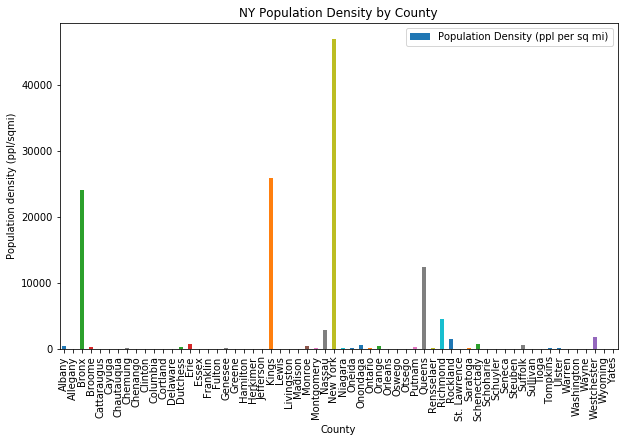

In [63]:
import matplotlib as mpl
import matplotlib.pyplot as plt
ny_counties['Population Density (ppl per sq mi)'] = ny_counties['Population Density (ppl per sq mi)'].astype(float)
ny_counties.plot(x = "County", y = "Population Density (ppl per sq mi)", kind = 'bar', figsize=(10,6))

plt.xlabel('County')
plt.ylabel('Population density (ppl/sqmi)')
plt.title('NY Population Density by County')
plt.show()

In [77]:
nyc_counties['County'].map(county_dic)
nyc_counties

,County,Population Density (ppl per sq mi),Population,Latitude,Longitude
2,Bronx,24118.20,"1,385,108",40.8507,-73.8665
23,Kings,25848.30,"2,504,700",40.6453,-73.955
30,New York,46961.00,"1,585,873",40.7896,-73.9599
40,Queens,12512.46,"2,230,722",40.7498,-73.7976
42,Richmond,4572.98,"468,730",40.5835,-74.1496


      County  Population Density (ppl per sq mi) Population Latitude Longitude
2      Bronx                            24118.20  1,385,108  40.8507  -73.8665
23     Kings                            25848.30  2,504,700  40.6453   -73.955
30  New York                            46961.00  1,585,873  40.7896  -73.9599
40    Queens                            12512.46  2,230,722  40.7498  -73.7976
42  Richmond                             4572.98    468,730  40.5835  -74.1496


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


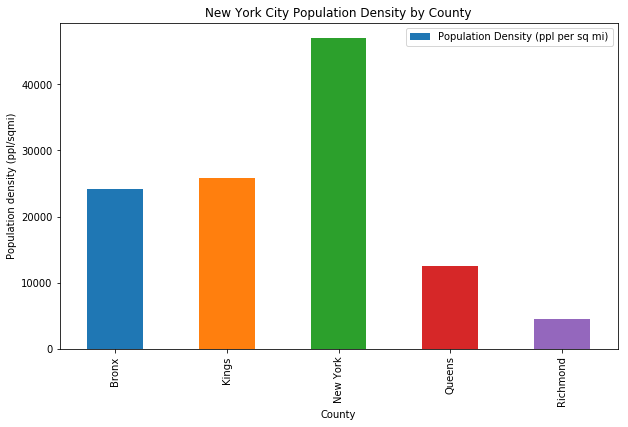

In [86]:
nyc_counties_table = nyc_counties # make a copy
nyc_counties_table['Population Density (ppl per sq mi)'] = nyc_counties_table['Population Density (ppl per sq mi)'].str.replace(',','',regex=True)
nyc_counties_table['Population Density (ppl per sq mi)'] = nyc_counties_table['Population Density (ppl per sq mi)'].astype(float)
print(nyc_counties_table)
nyc_counties_table.plot(x = "County", y = "Population Density (ppl per sq mi)", kind = 'bar', figsize=(10,6))

plt.xlabel('County')
plt.ylabel('Population density (ppl/sqmi)')
plt.title('New York City Population Density by County')
plt.show()

In [87]:
import folium
import requests

# Use Albany as map center since it's the capital of the state
address = 'Albany, New York'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('Location of State of NY: ', latitude, longitude)
# generate choropleth map using the population density of each county 
ny_map = folium.Map(location=[latitude, longitude], zoom_start=6.2)

Location of State of NY:  42.6511674 -73.754968


In [88]:
# load a GeoJSON file representing the NY counties
nycounties_geo = 'https://cugir.library.cornell.edu/download/file/cugir-007865-geojson.json'
nycounties_geo_json_data = json.loads(requests.get(nycounties_geo).text)

In [89]:
folium.GeoJson(nycounties_geo_json_data).add_to(ny_map)

ny_map

In [90]:
# Change datatype of population density to float
ny_counties['Population Density (ppl per sq mi)'] = ny_counties['Population Density (ppl per sq mi)'].str.replace(',', '')
ny_counties['Population Density (ppl per sq mi)'] = ny_counties['Population Density (ppl per sq mi)'].astype(float)

AttributeError: Can only use .str accessor with string values, which use np.object_ dtype in pandas

In [91]:
choropleth = folium.Choropleth(
    geo_data = nycounties_geo_json_data,
    data = ny_counties,
    columns=['County', 'Population Density (ppl per sq mi)'],
    key_on='feature.properties.name',
    fill_color='YlGnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Population Density'
).add_to(ny_map)

# add labels
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'], labels = False)
)

ny_map

The NYC area is much more populated than the rest of the state. To recalibrate the color map so the counties outside of the NYC area can be more differenciated in color, branca is used to reassign the colors. 

In [92]:
ny_map = folium.Map(location=[latitude, longitude], zoom_start=6.2)


from branca.colormap import linear

colormap = linear.YlGnBu_09.scale(
    ny_counties['Population Density (ppl per sq mi)'].min(),
    ny_counties['Population Density (ppl per sq mi)'].max())

colormap = colormap.to_step(
    n=10,
    index = np.linspace(2,1500, num = 10),
    data = ny_counties['Population Density (ppl per sq mi)'],
    method = 'quantiles'
    )

# print(colormap(5.0))

colormap

In [93]:
ny_counties_dict = ny_counties.set_index('County')['Population Density (ppl per sq mi)']
folium.GeoJson(nycounties_geo_json_data).add_to(ny_map)
choropleth = folium.GeoJson(
    data = nycounties_geo_json_data,
    name='Population density',
    style_function=lambda feature: {
        'fillColor': colormap(ny_counties_dict[feature['properties']['name']]),
        'color': 'black',
        'weight': 1,
        'dashArray': '5, 5',
        'fillOpacity': 0.9
    }
).add_to(ny_map)
colormap.add_to(ny_map)

ny_map

Visualize the Medical Centers in NYC

In [94]:
# Use Albany as map center since it's the capital of the state
address = 'New York City'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('Location of State of NY: ', latitude, longitude)
# generate choropleth map using the population density of each county 
nyc_map = folium.Map(location=[latitude, longitude], zoom_start=6.2)

Location of State of NY:  40.7127281 -74.0060152


In [95]:
# load a GeoJSON file representing the NY counties
nyc_geo = 'https://data.cityofnewyork.us/api/geospatial/tqmj-j8zm?method=export&format=GeoJSON'
nyc_geo_json_data = json.loads(requests.get(nyc_geo).text)
folium.GeoJson(nyc_geo_json_data).add_to(nyc_map)

nyc_map

In [96]:
for lat, lng, label in zip(ny_meds['Venue Latitude'], ny_meds['Venue Longitude'], ny_meds['Venue']):
    folium.CircleMarker(
        [lat, lng],
        radius=5, # define how big you want the circle markers to be
        color='yellow',
        fill=True,
        popup=label,
        fill_color='blue',
        fill_opacity=0.6
    ).add_to(nyc_map)

nyc_map

In [101]:
nyc_meds_bed = pd.read_csv("https://health.data.ny.gov/api/views/2g9y-7kqm/rows.csv?accessType=DOWNLOAD")
nyc_meds_bed = nyc_meds_bed.loc[nyc_meds_bed['County'].isin(['Bronx','Kings','New York','Queens','Richmond'])]
nyc_meds_bed

,Facility ID,Facility Name,Description,Short Description,Attribute Type,Attribute Value,Measure Value,Sub Type,County,Regional Office,Effective Date
2284,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Bed,RHCF,140.0,Permanent,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
2285,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Audiology,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
2286,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Baseline Services - Nursing Home,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
2287,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Dental,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
2288,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Medical Social Services,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
2289,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Nursing,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,12/30/2008
2290,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Nutritional,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,12/30/2008
2291,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Optometry,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,12/30/2008
2292,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Pharmaceutical Service,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
2293,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Service,Physician Services,0.0,NaN,Kings,Metropolitan Area Regional Office - New York City,10/01/1998


In [218]:
nyc_meds_bed = nyc_meds_bed[nyc_meds_bed['Measure Value']!= 0]
nyc_meds_bed

,Facility ID,Facility Name,Description,Short Description,Attribute Type,Attribute Value,Measure Value,Sub Type,County,Regional Office,Effective Date
2284,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Bed,RHCF,140.0,Permanent,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
7196,856,Grand Manor Nursing & Rehabilitation Center,Residential Health Care Facility - SNF,NH,Bed,RHCF,240.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,01/01/1991
9803,1164,BronxCare Hospital Center,Hospital,HOSP,Bed,Chemical Dependence - Rehabilitation,30.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,05/28/1991
9804,1164,BronxCare Hospital Center,Hospital,HOSP,Bed,Chemical Dependence - Detoxification,36.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,12/30/2008
9805,1164,BronxCare Hospital Center,Hospital,HOSP,Bed,Psychiatric,104.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,10/18/2018
9830,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Burns Care,8.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,06/01/2006
9831,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Chemical Dependence - Detoxification,16.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,12/30/2008
9832,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Coronary Care,12.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,02/01/1980
9833,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Intensive Care,24.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,06/01/2006
9834,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Maternity,26.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,02/01/1980


In [219]:
nyc_meds_bed = nyc_meds_bed[['Facility Name', 'Attribute Type', 'Attribute Value','Measure Value', 'County']]
nyc_meds_beds = nyc_meds_bed.groupby(['Facility Name','County'],as_index=False).sum()
nyc_meds_beds = nyc_meds_beds[nyc_meds_beds['Measure Value'] != 0].reset_index(drop=True)
nyc_meds_beds

,Facility Name,County,Measure Value
0,Amsterdam Nursing Home Corp (1992),New York,409.0
1,Atrium Center for Rehabilitation and Nursing,Kings,380.0
2,Bainbridge Nursing & Rehabilitation Center,Bronx,200.0
3,Beach Gardens Rehab and Nursing Center,Queens,163.0
4,Beacon Rehabilitation and Nursing Center,Queens,120.0
5,Bedford Center for Nursing and Rehabilitation,Kings,200.0
6,Bellevue Hospital Center,New York,912.0
7,Bensonhurst Center for Rehabilitation and Heal...,Kings,200.0
8,Beth Abraham Center for Rehabilitation and Nur...,Bronx,448.0
9,Bezalel Rehabilitation and Nursing Center,Queens,120.0


<a id='results'></a>
# 4. Results

First, I'd like to understand the relationship between the number of bed with the population of each county.

In [115]:
nyc_meds_beds_by_county = nyc_meds_beds.groupby(['County'],as_index=False).sum()
nyc_meds_beds_by_county

,County,Measure Value
0,Bronx,18316.0
1,Kings,20855.0
2,New York,19585.0
3,Queens,17765.0
4,Richmond,5240.0


In [116]:
nyc_counties_population = nyc_counties[['County','Population']]
nyc_counties_population

,County,Population
2,Bronx,"1,385,108"
23,Kings,"2,504,700"
30,New York,"1,585,873"
40,Queens,"2,230,722"
42,Richmond,"468,730"


In [121]:
nyc_counties_bed_by_population = nyc_counties_population.merge(nyc_meds_beds_by_county, on="County")
nyc_counties_bed_by_population

,County,Population,Measure Value
0,Bronx,"1,385,108",18316.0
1,Kings,"2,504,700",20855.0
2,New York,"1,585,873",19585.0
3,Queens,"2,230,722",17765.0
4,Richmond,"468,730",5240.0


Text(0,0.5,'Number of Beds')

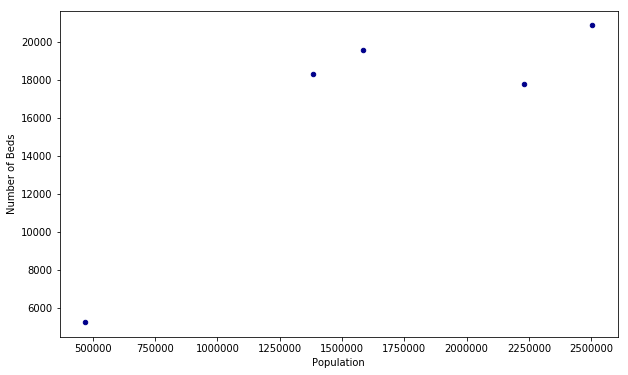

In [134]:
nyc_counties_bed_by_population['Population']=nyc_counties_bed_by_population['Population'].str.replace(',','')
nyc_counties_bed_by_population['Population']=nyc_counties_bed_by_population['Population'].astype(float)
nyc_counties_bed_by_population.plot(kind='scatter',
                                    x = 'Population',
                                    y = 'Measure Value',
                                    figsize = (10,6),
                                    color = 'darkblue'
                                    )
plt.xlabel('Population')
plt.ylabel('Number of Beds')

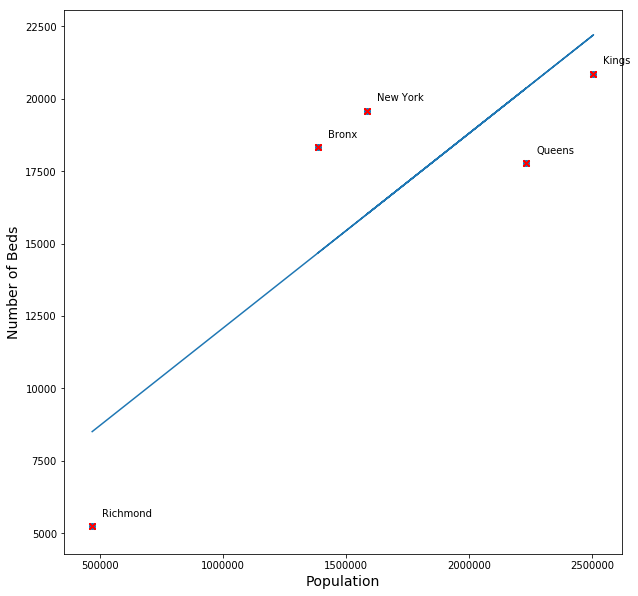

In [138]:
x = nyc_counties_bed_by_population['Population'].values
y = nyc_counties_bed_by_population['Measure Value'].values
County = nyc_counties_bed_by_population['County'].values

fig, ax = plt.subplots(figsize=(10,10))
ax.scatter(x, y)

ax.set_xlabel('Population', fontsize=14)
ax.set_ylabel('Number of Beds', fontsize=14)

m, b = np.polyfit(x, y, 1)
plt.plot(x, m*x + b)

for i, txt in enumerate(County):
    ax.annotate(txt, (x[i], y[i]), xytext=(10,10), textcoords='offset points')
    plt.scatter(x, y, marker='x', color='red')

Then I'd like to understand what type of beds are available in each registered facility

In [4]:
nyc_meds_bed = pd.read_csv("https://health.data.ny.gov/api/views/2g9y-7kqm/rows.csv?accessType=DOWNLOAD")
nyc_meds_bed = nyc_meds_bed.loc[nyc_meds_bed['County'].isin(['Bronx','Kings','New York','Queens','Richmond'])]
nyc_meds_bed['Measure Value'] = nyc_meds_bed['Measure Value'].fillna(0)
nyc_meds_bed = nyc_meds_bed[nyc_meds_bed['Measure Value']!= 0]
nyc_meds_bed = nyc_meds_bed[nyc_meds_bed['Attribute Type'] == 'Bed']
nyc_meds_bed

,Facility ID,Facility Name,Description,Short Description,Attribute Type,Attribute Value,Measure Value,Sub Type,County,Regional Office,Effective Date
2284,277,Brooklyn-Queens Nursing Home,Residential Health Care Facility - SNF,NH,Bed,RHCF,140.0,Permanent,Kings,Metropolitan Area Regional Office - New York City,10/01/1998
7196,856,Grand Manor Nursing & Rehabilitation Center,Residential Health Care Facility - SNF,NH,Bed,RHCF,240.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,01/01/1991
9803,1164,BronxCare Hospital Center,Hospital,HOSP,Bed,Chemical Dependence - Rehabilitation,30.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,05/28/1991
9804,1164,BronxCare Hospital Center,Hospital,HOSP,Bed,Chemical Dependence - Detoxification,36.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,12/30/2008
9805,1164,BronxCare Hospital Center,Hospital,HOSP,Bed,Psychiatric,104.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,10/18/2018
9830,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Burns Care,8.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,06/01/2006
9831,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Chemical Dependence - Detoxification,16.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,12/30/2008
9832,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Coronary Care,12.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,02/01/1980
9833,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Intensive Care,24.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,06/01/2006
9834,1165,Jacobi Medical Center,Hospital,HOSP,Bed,Maternity,26.0,Permanent,Bronx,Metropolitan Area Regional Office - New York City,02/01/1980


In [6]:
# Get unique values of the bed types
nyc_meds_bed_bedtype = nyc_meds_bed['Attribute Value'].unique()
nyc_meds_bed_bedtype

array(['RHCF', 'Chemical Dependence  - Rehabilitation',
       'Chemical Dependence - Detoxification', 'Psychiatric',
       'Burns Care', 'Coronary Care', 'Intensive Care', 'Maternity',
       'Medical / Surgical', 'Neonatal Continuing Care',
       'Neonatal Intensive Care', 'Neonatal Intermediate Care',
       'Pediatric', 'Pediatric ICU',
       'Physical Medicine and Rehabilitation', 'AIDS',
       'Bone Marrow Transplant', 'Ventilator Dependent', 'Coma Recovery',
       'Traumatic Brain Injury', 'Prisoner', 'Respiratory',
       'Transitional Care', 'Neurodegenerative', 'Residence',
       'Behavioral Intervention '], dtype=object)

In [7]:
nyc_meds_bed_facility_name = nyc_meds_bed['Facility Name'].unique()
len(nyc_meds_bed_facility_name)

231

In [8]:
ny_meds

NameError: name 'ny_meds' is not defined

In [158]:
ny_meds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 7 columns):
County              500 non-null object
County Latitude     500 non-null float64
County Longitude    500 non-null float64
Venue               500 non-null object
Venue Latitude      500 non-null float64
Venue Longitude     500 non-null float64
Venue Category      500 non-null object
dtypes: float64(4), object(3)
memory usage: 27.4+ KB


In [160]:
ny_meds_facility_name = ny_meds ['Venue'].unique()
ny_meds_facility_name

array(['Montefiore Medical Center (Albert Einstein College of Medicine)',
       'Milstein Heart Center', 'Montefiore Medical Pavillion',
       'Herbert Irving Pavilion', 'Bronx Lebanon - Fulton Division',
       'Bronx VA Medical Center', 'Isabella Geriatric',
       'Montefiore Medical Group - Bronx East',
       'NewYork-Presbyterian/The Allen Hospital', 'IHS Dialysis Center',
       'East Haven Nursing & Rehabilitation Center',
       'New York Cancer & Blood Specialists',
       'New york eye surgery center', 'Island Rehabilitative Dialysis',
       'Eye Care Unlimited', 'Bronx VA Canteen',
       'Montefiore New Rochelle Hospital',
       "St. Patrick's Home for the Aged and Infirm",
       'Dr. Kwadwo Boakye M.D., P.C.', 'Montefiore Medical Group',
       'Riverdale Nursing Home', 'Schervier Nursing Care Center',
       'Bronx Gastroenterology', 'NYPD - 44th Precinct',
       'Planned Parenthood - The Bronx Center',
       'Park Professional Eyecare',
       'Segundo Ruiz Belvi

In [161]:
set(nyc_meds_bed_facility_name) & set(ny_meds_facility_name)

{'Calvary Hospital',
 'Crown Heights Center for Nursing and Rehabilitation',
 'East Haven Nursing & Rehabilitation Center',
 'Highland Care Center',
 'Hospital for Special Surgery',
 'Kings County Hospital Center',
 'Lenox Hill Hospital',
 'Maimonides Medical Center',
 'Mount Sinai Brooklyn',
 'NewYork-Presbyterian Brooklyn Methodist Hospital',
 'North Central Bronx Hospital',
 'Queens Hospital Center',
 'Richmond University Medical Center',
 'Riverdale Nursing Home',
 'Schervier Nursing Care Center',
 'University Hospital of Brooklyn',
 'Woodhull Medical & Mental Health Center',
 'Wyckoff Heights Medical Center'}

Because the exact match between the facility in the registry with bed information does not match with the facilities acquired from Foursquare with geolocation information, the facility with bed information will be used for clustering. 

In [9]:
nyc_meds_facility_bed_type = pd.DataFrame(nyc_meds_bed_bedtype)
nyc_meds_facility_bed_type = nyc_meds_facility_bed_type.transpose()
nyc_meds_facility_bed_type.columns = nyc_meds_facility_bed_type.iloc[0]
nyc_meds_facility_bed_type.drop(nyc_meds_facility_bed_type.index[0],inplace=True)

nyc_meds_facility_bed_type["County"] = ""
#move the last column to first column
cols = list(nyc_meds_facility_bed_type.columns)
cols = [cols[-1]] + cols[:-1]
nyc_meds_facility_bed_type = nyc_meds_facility_bed_type[cols]

nyc_meds_facility_bed_type['Facility'] = nyc_meds_bed_facility_name

#move the last column to first column
cols = list(nyc_meds_facility_bed_type.columns)
cols = [cols[-1]] + cols[:-1]
nyc_meds_facility_bed_type = nyc_meds_facility_bed_type[cols]


nyc_meds_facility_bed_type

,Facility,County,RHCF,Chemical Dependence - Rehabilitation,Chemical Dependence - Detoxification,Psychiatric,Burns Care,Coronary Care,Intensive Care,Maternity,Medical / Surgical,Neonatal Continuing Care,Neonatal Intensive Care,Neonatal Intermediate Care,Pediatric,Pediatric ICU,Physical Medicine and Rehabilitation,AIDS,Bone Marrow Transplant,Ventilator Dependent,Coma Recovery,Traumatic Brain Injury,Prisoner,Respiratory,Transitional Care,Neurodegenerative,Residence,Behavioral Intervention
0,Brooklyn-Queens Nursing Home,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Grand Manor Nursing & Rehabilitation Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,BronxCare Hospital Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Jacobi Medical Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Montefiore Medical Center-Wakefield Hospital,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Montefiore Medical Center - Henry & Lucy Moses...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Lincoln Medical & Mental Health Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Calvary Hospital Inc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,SBH Health System,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,North Central Bronx Hospital,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Fill the informaiton of number of bed per bed type by facility

In [10]:
nyc_meds_facility_bed_type_filled = nyc_meds_facility_bed_type
nyc_meds_facility_bed_type_filled = nyc_meds_facility_bed_type_filled.set_index('Facility') 
nyc_meds_facility_bed_type_filled

,County,RHCF,Chemical Dependence - Rehabilitation,Chemical Dependence - Detoxification,Psychiatric,Burns Care,Coronary Care,Intensive Care,Maternity,Medical / Surgical,Neonatal Continuing Care,Neonatal Intensive Care,Neonatal Intermediate Care,Pediatric,Pediatric ICU,Physical Medicine and Rehabilitation,AIDS,Bone Marrow Transplant,Ventilator Dependent,Coma Recovery,Traumatic Brain Injury,Prisoner,Respiratory,Transitional Care,Neurodegenerative,Residence,Behavioral Intervention
Facility,,,,,,,,,,,,,,,,,,,,,,,,,,,
Brooklyn-Queens Nursing Home,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Grand Manor Nursing & Rehabilitation Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BronxCare Hospital Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Jacobi Medical Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Montefiore Medical Center-Wakefield Hospital,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Montefiore Medical Center - Henry & Lucy Moses Div,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lincoln Medical & Mental Health Center,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Calvary Hospital Inc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SBH Health System,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
for index, nyc_meds_bed_row in nyc_meds_bed.iterrows():
        nyc_meds_facility_bed_type_filled_row = nyc_meds_bed_row['Facility Name']
        nyc_meds_facility_bed_type_filled_column = nyc_meds_bed_row ['Attribute Value']
        nyc_meds_facility_bed_type_filled.loc[[nyc_meds_facility_bed_type_filled_row],[nyc_meds_facility_bed_type_filled_column]]= nyc_meds_bed_row['Measure Value']
        nyc_meds_facility_bed_type_filled.loc[[nyc_meds_facility_bed_type_filled_row],['County']] = nyc_meds_bed_row['County']
nyc_meds_facility_bed_type_filled = nyc_meds_facility_bed_type_filled.fillna(0)
nyc_meds_facility_bed_type_filled.head(10)

,County,RHCF,Chemical Dependence - Rehabilitation,Chemical Dependence - Detoxification,Psychiatric,Burns Care,Coronary Care,Intensive Care,Maternity,Medical / Surgical,Neonatal Continuing Care,Neonatal Intensive Care,Neonatal Intermediate Care,Pediatric,Pediatric ICU,Physical Medicine and Rehabilitation,AIDS,Bone Marrow Transplant,Ventilator Dependent,Coma Recovery,Traumatic Brain Injury,Prisoner,Respiratory,Transitional Care,Neurodegenerative,Residence,Behavioral Intervention
Facility,,,,,,,,,,,,,,,,,,,,,,,,,,,
Brooklyn-Queens Nursing Home,Kings,140.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Grand Manor Nursing & Rehabilitation Center,Bronx,240.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BronxCare Hospital Center,Bronx,0.0,30.0,36.0,104.0,0.0,11.0,26.0,36.0,250.0,6.0,14.0,20.0,25.0,5.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Jacobi Medical Center,Bronx,0.0,0.0,16.0,107.0,8.0,12.0,24.0,26.0,174.0,5.0,10.0,10.0,33.0,8.0,24.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Montefiore Medical Center-Wakefield Hospital,Bronx,0.0,0.0,0.0,33.0,0.0,0.0,16.0,30.0,206.0,2.0,4.0,9.0,5.0,0.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Montefiore Medical Center - Henry & Lucy Moses Div,Bronx,0.0,0.0,0.0,22.0,0.0,12.0,48.0,0.0,581.0,0.0,0.0,0.0,116.0,20.0,0.0,13.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Lincoln Medical & Mental Health Center,Bronx,0.0,0.0,0.0,60.0,0.0,7.0,23.0,35.0,177.0,10.0,5.0,5.0,32.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Calvary Hospital Inc,Bronx,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SBH Health System,Bronx,0.0,0.0,24.0,49.0,0.0,0.0,26.0,16.0,254.0,5.0,0.0,10.0,16.0,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Run k-means to cluster the facilities into 4 clusters

In [12]:
from sklearn.cluster import KMeans

# set number of clusters
kclusters = 4

nyc_meds_facility_bed_type_filled_clustering = nyc_meds_facility_bed_type_filled.drop('County', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(nyc_meds_facility_bed_type_filled_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 0, 2, 2, 2, 2, 2, 2, 2, 1])

In [13]:
# add clustering labels
nyc_meds_facility_bed_type_filled.insert(0, 'Cluster Labels', kmeans.labels_)

In [14]:
nyc_meds_facility_bed_type_filled

,Cluster Labels,County,RHCF,Chemical Dependence - Rehabilitation,Chemical Dependence - Detoxification,Psychiatric,Burns Care,Coronary Care,Intensive Care,Maternity,Medical / Surgical,Neonatal Continuing Care,Neonatal Intensive Care,Neonatal Intermediate Care,Pediatric,Pediatric ICU,Physical Medicine and Rehabilitation,AIDS,Bone Marrow Transplant,Ventilator Dependent,Coma Recovery,Traumatic Brain Injury,Prisoner,Respiratory,Transitional Care,Neurodegenerative,Residence,Behavioral Intervention
Facility,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Brooklyn-Queens Nursing Home,1,Kings,140.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Grand Manor Nursing & Rehabilitation Center,0,Bronx,240.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
BronxCare Hospital Center,2,Bronx,0.0,30.0,36.0,104.0,0.0,11.0,26.0,36.0,250.0,6.0,14.0,20.0,25.0,5.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Jacobi Medical Center,2,Bronx,0.0,0.0,16.0,107.0,8.0,12.0,24.0,26.0,174.0,5.0,10.0,10.0,33.0,8.0,24.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Montefiore Medical Center-Wakefield Hospital,2,Bronx,0.0,0.0,0.0,33.0,0.0,0.0,16.0,30.0,206.0,2.0,4.0,9.0,5.0,0.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Montefiore Medical Center - Henry & Lucy Moses Div,2,Bronx,0.0,0.0,0.0,22.0,0.0,12.0,48.0,0.0,581.0,0.0,0.0,0.0,116.0,20.0,0.0,13.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Lincoln Medical & Mental Health Center,2,Bronx,0.0,0.0,0.0,60.0,0.0,7.0,23.0,35.0,177.0,10.0,5.0,5.0,32.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Calvary Hospital Inc,2,Bronx,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SBH Health System,2,Bronx,0.0,0.0,24.0,49.0,0.0,0.0,26.0,16.0,254.0,5.0,0.0,10.0,16.0,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [15]:
nyc_meds_bed_type  = nyc_meds_facility_bed_type_filled.drop('County',1)
nyc_meds_bed_type = nyc_meds_bed_type.set_index('Cluster Labels')
nyc_meds_bed_type = nyc_meds_bed_type.groupby('Cluster Labels').mean()
nyc_meds_bed_type

,RHCF,Chemical Dependence - Rehabilitation,Chemical Dependence - Detoxification,Psychiatric,Burns Care,Coronary Care,Intensive Care,Maternity,Medical / Surgical,Neonatal Continuing Care,Neonatal Intensive Care,Neonatal Intermediate Care,Pediatric,Pediatric ICU,Physical Medicine and Rehabilitation,AIDS,Bone Marrow Transplant,Ventilator Dependent,Coma Recovery,Traumatic Brain Injury,Prisoner,Respiratory,Transitional Care,Neurodegenerative,Residence,Behavioral Intervention
Cluster Labels,,,,,,,,,,,,,,,,,,,,,,,,,,
0,251.321739,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.278261,0.000000,0.000000,2.400000,0.0,4.573913,0.000000,0.704348,0.000000,0.000000,0.000000,0.417391,0.000000,0.000000
1,57.694915,0.745763,2.542373,10.305085,0.050847,0.711864,2.220339,3.627119,24.813559,0.389831,0.915254,0.881356,3.254237,0.050847,1.440678,9.644068,0.0,1.474576,0.118644,0.389831,0.000000,0.000000,0.000000,0.000000,0.542373,2.440678
2,0.000000,2.341463,6.024390,53.097561,1.000000,8.365854,31.292683,28.756098,304.048780,4.390244,7.341463,7.317073,25.219512,6.170732,13.975610,6.414634,1.0,0.000000,0.170732,1.512195,0.829268,1.317073,0.707317,0.000000,0.000000,0.000000
3,578.187500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,2.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [18]:
nyc_meds_bed_type.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4 entries, 0 to 3
Data columns (total 26 columns):
RHCF                                     4 non-null float64
Chemical Dependence  - Rehabilitation    4 non-null float64
Chemical Dependence - Detoxification     4 non-null float64
Psychiatric                              4 non-null float64
Burns Care                               4 non-null float64
Coronary Care                            4 non-null float64
Intensive Care                           4 non-null float64
Maternity                                4 non-null float64
Medical / Surgical                       4 non-null float64
Neonatal Continuing Care                 4 non-null float64
Neonatal Intensive Care                  4 non-null float64
Neonatal Intermediate Care               4 non-null float64
Pediatric                                4 non-null float64
Pediatric ICU                            4 non-null float64
Physical Medicine and Rehabilitation     4 non-null float64

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25]),
 <a list of 26 Text xticklabel objects>)

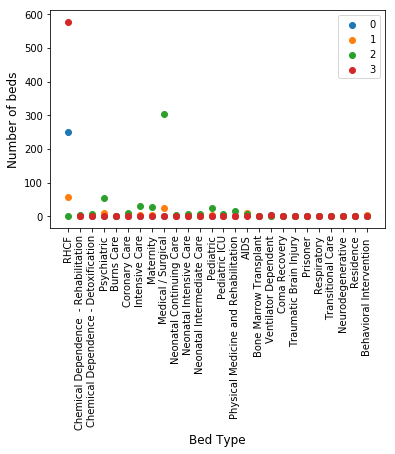

In [49]:
x = range(0,len(nyc_meds_bed_type.columns))
# fig, ax = plt.subplots()
for index, row in nyc_meds_bed_type.iterrows():
    row_mod = row.transpose()
    legend = index
    plt.scatter(x, row_mod)
plt.xlabel("Bed Type",fontsize=12)  
plt.ylabel("Number of beds",fontsize=12)
plt.legend()
plt.xticks(x, nyc_meds_bed_type.columns.tolist())
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25]),
 <a list of 26 Text xticklabel objects>)

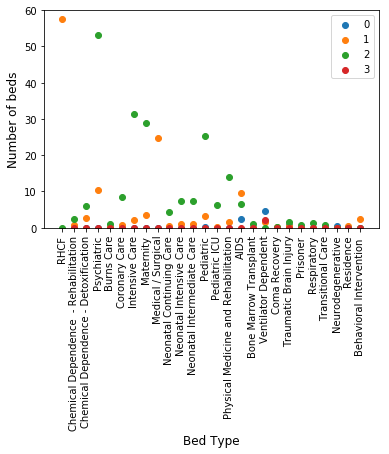

In [51]:
x = range(0,len(nyc_meds_bed_type.columns))
# fig, ax = plt.subplots()
for index, row in nyc_meds_bed_type.iterrows():
    row_mod = row.transpose()
    legend = index
    plt.scatter(x, row_mod)
plt.xlabel("Bed Type",fontsize=12)  
plt.ylabel("Number of beds",fontsize=12)
plt.ylim(0,60)
plt.legend()
plt.xticks(x, nyc_meds_bed_type.columns.tolist())
plt.xticks(rotation=90)

We'd like to understand the percentage of each category in each counties. 

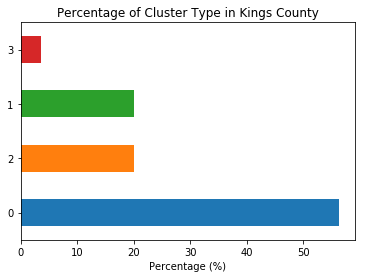

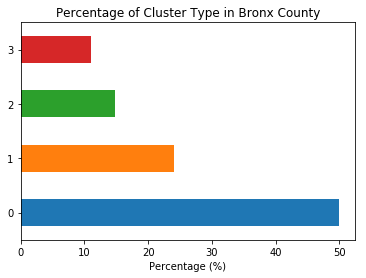

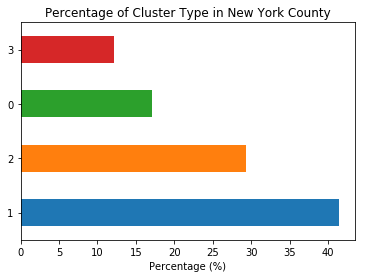

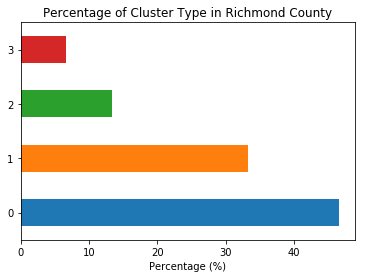

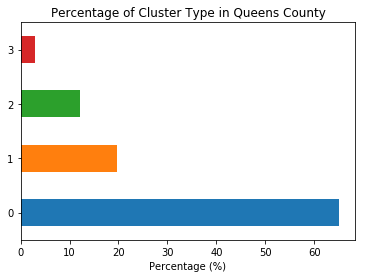

In [65]:
counties = nyc_meds_facility_bed_type_filled['County'].unique()
for county in counties:
    nyc_meds_county_cluster = nyc_meds_facility_bed_type_filled.loc[nyc_meds_facility_bed_type_filled['County'] == county]
    # calculate percentage of cluster type
    nyc_meds_county_cluster_percentage = nyc_meds_county_cluster['Cluster Labels'].value_counts(normalize=True) * 100
    nyc_meds_county_cluster_percentage.plot(kind='barh')
    plt.xlabel('Percentage (%)')
    title = 'Percentage of Cluster Type in ' + county +' County'
    plt.title(title)
    plt.show()

<a id='discussion'></a>
# 5. Discussion

Data shows that Category 0 has a high number of beds for RHCF but is not exclusive, Category 1 has relatively higher capacity for medsurg and AIDS patients, Category 2 has large capacity for psychiatric patients as well as for intensive care and pediatric patients, and Category 3 has exclusively RHCF facilities with beds. 

<a id='conclusion'></a>
# 6. Conclusion

The resource of bed capacity in health system in NYC is relatively evenly distributed across all five counties, which capacity to population ratio slightly higher in Bronx and New York county (Manhattan) than other three counties. There seem to be an abundance of facilities with exclusive resource for RHCF patients in Queens and Kings (Brooklyn) counties, while the resource diversified for psychiatric, intensive care and pediatric patients is relatively scarce in Queens compared to other counties. There is also a higher ratio of facilities with higher capacities for medsurg and AIDS patients in New York county (Manhattan) and in Richmond (Staten Island) compared to Queens and Kings (Brooklyn) counties. 